In [183]:
import os

import nltk
from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer

from sklearn.feature_extraction import DictVectorizer
from sklearn.feature_extraction.text import TfidfTransformer

In [45]:
STOPWORDS = stopwords.words('spanish')
spanish_sentence_tokenizer = nltk.data.load('tokenizers/punkt/spanish.pickle')
tokenizer = RegexpTokenizer(r'\w+')
dict_vectorizer = DictVectorizer()

In [38]:
folder_path = '/opt/projects/mensaje_presidencial/textos/txt'
files = sorted(os.listdir(folder_path))

messages = []
all_counts = []

for file in files:
    print(file)
    if not file.startswith('.'):
        message = {}
        [year, president] = file.split('.')[0].split('_')
        message['year'] = year
        message['president'] = president
        txt_path = os.path.join(folder_path, file)
        with open(txt_path, 'r') as fopen:
            text = fopen.read()
            paragraphs = text.split("\n\n")
            
            all_sentences = []
            counts = {}
            # locations = {}
            # idx_sent = 0

            for paragraph in paragraphs:
                sentences = spanish_sentence_tokenizer.tokenize(paragraph)
                all_sentences.extend(sentences)
                for sentence in sentences:
                    words = tokenizer.tokenize(sentence)
                    for word in words:
                        word = word.lower()
                        if not word in STOPWORDS and not word.isnumeric():
                            if word in counts:
                                counts[word] +=1
            #                     locations[word].append(idx_sent)
                            else:
                                counts[word] = 1  
            #                     locations[word] = [idx_sent]
            #         idx_sent += 1
            all_counts.append(counts)
            message['sentences'] = all_sentences
        messages.append(message)
    
# print(messages)

.DS_Store
1990_PatricioAylwin.txt
1991_PatricioAylwin.txt
1992_PatricioAylwin.txt
1993_PatricioAylwin.txt
1994_EduardoFrei.txt
1995_EduardoFrei.txt
1996_EduardoFrei.txt
1997_EduardoFrei.txt
1998_EduardoFrei.txt
1999_EduardoFrei.txt
2000_RicardoLagos.txt
2001_RicardoLagos.txt
2002_RicardoLagos.txt
2003_RicardoLagos.txt
2004_RicardoLagos.txt
2005_RicardoLagos.txt
2006_MichelleBachelet.txt
2007_MichelleBachelet.txt
2008_MichelleBachelet.txt
2009_MichelleBachelet.txt
2010_SebastianPinera.txt
2011_SebastianPinera.txt
2012_SebastianPinera.txt
2013_SebastianPinera.txt
2014_MichelleBachelet.txt
2015_MichelleBachelet.txt
2016_MichelleBachelet.txt
2017_MichelleBachelet.txt
2018_SebastianPinera.txt


In [7]:
print(files)

['2005_RicardoLagos.txt', '2017_MichelleBachelet.txt', '1995_EduardoFrei.txt', '.DS_Store', '2001_RicardoLagos.txt', '2018_SebastianPinera.txt', '2004_RicardoLagos.txt', '1993_PatricioAylwin.txt', '2016_MichelleBachelet.txt', '2010_SebastianPinera.txt', '2011_SebastianPinera.txt', '2012_SebastianPinera.txt', '1994_EduardoFrei.txt', '2000_RicardoLagos.txt', '2013_SebastianPinera.txt', '1990_PatricioAylwin.txt', '2008_MichelleBachelet.txt', '1991_PatricioAylwin.txt', '2007_MichelleBachelet.txt', '2015_MichelleBachelet.txt', '1999_EduardoFrei.txt', '2003_RicardoLagos.txt', '1992_PatricioAylwin.txt', '1996_EduardoFrei.txt', '1998_EduardoFrei.txt', '2006_MichelleBachelet.txt', '2009_MichelleBachelet.txt', '1997_EduardoFrei.txt', '2002_RicardoLagos.txt', '2014_MichelleBachelet.txt']


In [141]:
count_matrix = dict_vectorizer.fit_transform(all_counts)
feature_names = dict_vectorizer.get_feature_names()

all_cnts = count_matrix.sum(axis=0).getA()[0]
greater_than = all_cnts > 10
filtered_cnts = count_matrix[:, greater_than]
filtered_features = np.array(feature_names)[greater_than]
filtered_cnts.shape

(29, 3400)

In [142]:
words_obj = {}
for idx_feature, feature in enumerate(filtered_features):
    words_obj[feature] = list(filtered_cnts[:, idx_feature].toarray().flatten())

In [143]:
years = list(range(1990, 2019))
print(len(years))

29


In [150]:
filtered_features

array(['1º', '2º', '3º', '4º', 'abastecimiento', 'abierta', 'abierto',
       'abiertos', 'abordar', 'abre', 'abren', 'abriendo', 'abril',
       'abrir', 'abuso', 'abusos', 'acaba', 'acabamos', 'académicos',
       'accedan', 'acceder', 'acceso', 'accidentes', 'acciones', 'acción',
       'acelerar', 'aceptar', 'acerca', 'acercar', 'acogida',
       'acompañado', 'acorde', 'acreditación', 'actitud', 'activa',
       'activamente', 'actividad', 'actividades', 'activo', 'activos',
       'acto', 'actor', 'actores', 'actos', 'actuado', 'actual',
       'actuales', 'actualidad', 'actualizar', 'actualmente', 'actuando',
       'actuar', 'acuerdo', 'acuerdos', 'acuicultura', 'acá',
       'adaptación', 'adecuada', 'adecuadamente', 'adecuadas', 'adecuado',
       'adecuados', 'adecuar', 'adelante', 'además', 'adicional',
       'adicionales', 'adicionalmente', 'administración', 'administrar',
       'administrativa', 'administrativas', 'administrativo',
       'administrativos', 'adolescenci

### Data exploration

In [172]:
%matplotlib inline

import matplotlib
import matplotlib.pyplot as plt

import numpy as np
np.set_printoptions(threshold=np.nan)

import functools 
import time

In [157]:
concepts = [{'concept': 'mejor', 'synonyms': ['mejor', 'mejora', 'mejorado', 'mejoramiento', 'mejoramos', 
                                              'mejorando', 'mejorar', 'mejoraremos', 'mejoras', 'mejoren', 
                                              'mejores', 'mejoría']},
            {'concept': 'terrorismo', 'synonyms': ['terrorismo', 'terroristas']},
            {'concept': 'inversiones', 'synonyms': ['inversiones', 'inversionistas', 'inversión', 'invertir']},
            {'concept': 'terremoto', 'synonyms': ['terremoto']}
           ]


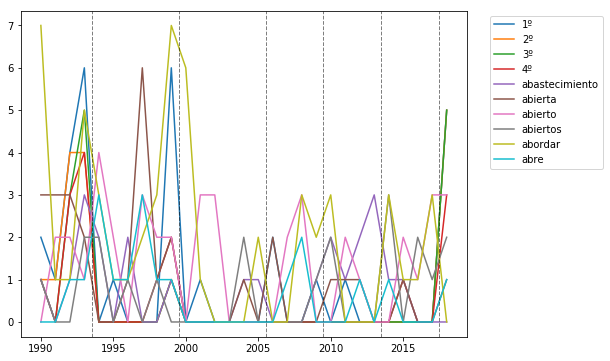

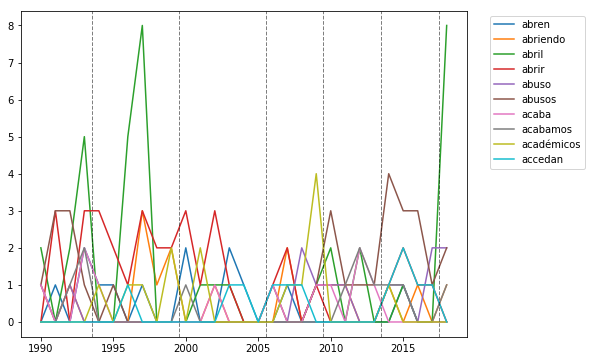

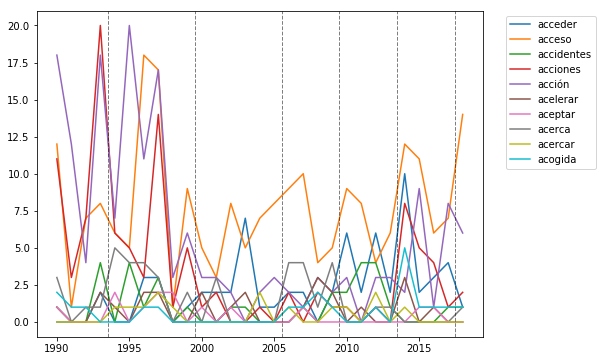

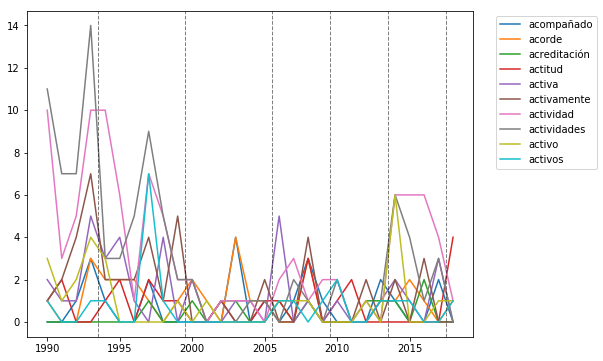

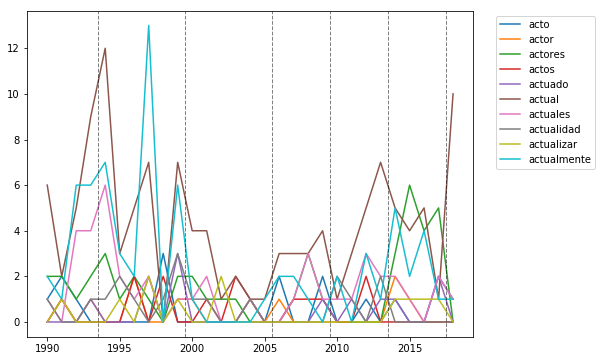

...

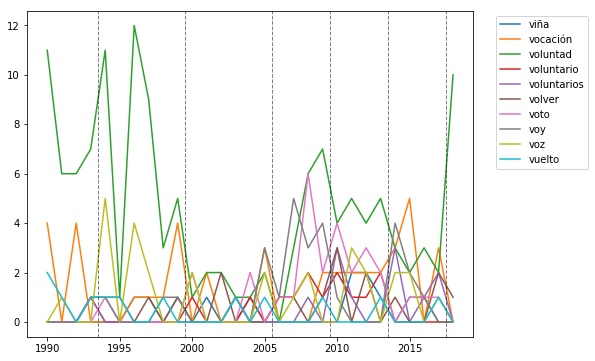

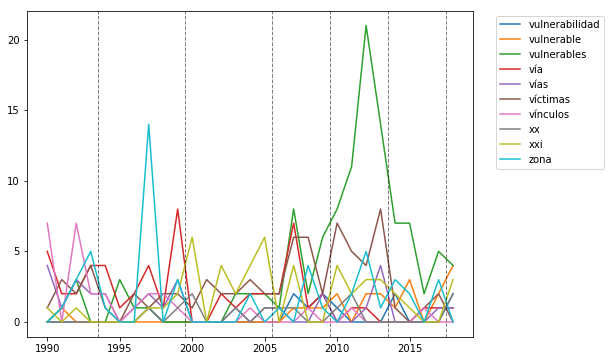

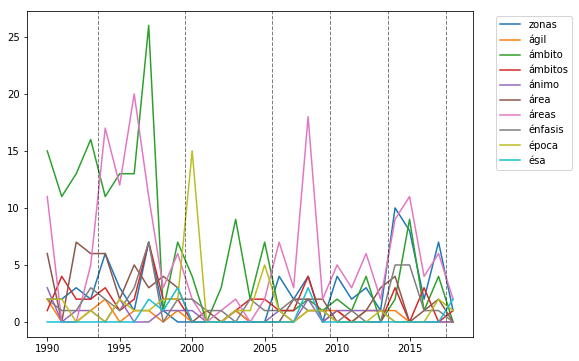

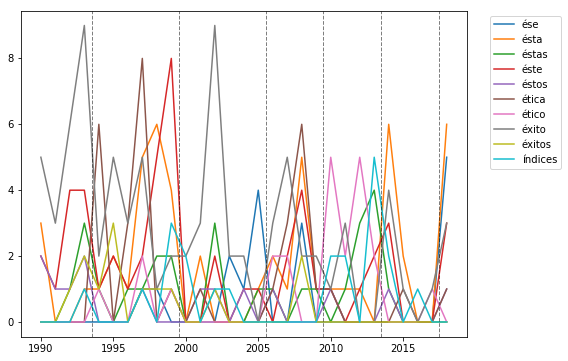

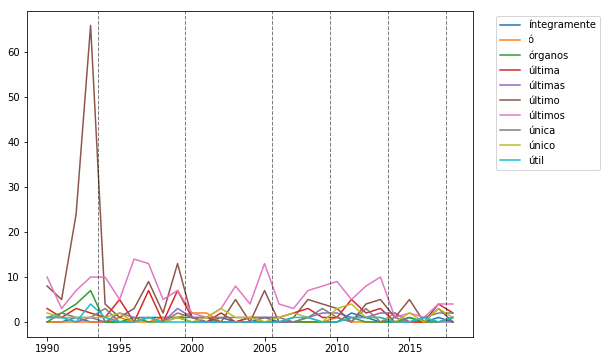

No handles with labels found to put in legend.


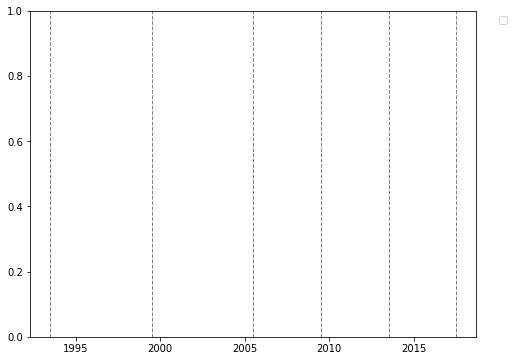

In [180]:
delta = 10

for initial in range(0, len(filtered_features)+1, delta):
    fig = plt.figure(figsize=(8,6))
    ax = fig.add_subplot(1, 1, 1)

    # for concept in concepts:
    #     total_counts = np.zeros(len(years))
    #     synonyms = concept['synonyms']
    #     for synonym in synonyms:
    #         total_counts += words_obj[synonym]  
    #     plt.plot(years, total_counts, label=concept['concept'])

    final = initial + delta
    for idx_feature, feature in enumerate(filtered_features[initial:final]):
        ax.plot(years, words_obj[feature], label=feature)
    ymin, ymax = plt.ylim()
    ax.plot([1993.5, 1993.5], [ymin, ymax], 'k--', linewidth=1, alpha=0.5)
    ax.plot([1999.5, 1999.5], [ymin, ymax], 'k--', linewidth=1, alpha=0.5)
    ax.plot([2005.5, 2005.5], [ymin, ymax], 'k--', linewidth=1, alpha=0.5)
    ax.plot([2009.5, 2009.5], [ymin, ymax], 'k--', linewidth=1, alpha=0.5)
    ax.plot([2013.5, 2013.5], [ymin, ymax], 'k--', linewidth=1, alpha=0.5)
    ax.plot([2017.5, 2017.5], [ymin, ymax], 'k--', linewidth=1, alpha=0.5)
    plt.ylim(ymin, ymax)
    plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
    plt.show()

#### Ideas: 
* tf-idf para cada mensaje

In [184]:
tfidf_transformer = TfidfTransformer()
tfidf_matrix = tfidf_transformer.fit_transform(filtered_cnts)

In [217]:
all_cnts = count_matrix.sum(axis=0).getA()[0]
greater_than = np.where((all_cnts > 10) & (all_cnts < 800))[0]
refined_cnts = count_matrix[:, greater_than]
refined_features = np.array(feature_names)[greater_than]
tfidf_matrix = tfidf_transformer.fit_transform(refined_cnts)

In [218]:
for idx_year, year in enumerate(years):
    idx_sort = np.argsort(tfidf_matrix[idx_year, :].toarray())[0][::-1]
    top_terms = refined_features[idx_sort[:10]]
    print(year)
    print(top_terms)
        

1990
['política' 'sector' 'recursos' 'social' 'mayor' 'sólo' 'situación'
 'educación' 'capacidad' 'sectores']
1991
['terrorismo' 'terroristas' 'derechos' 'social' 'democracia' 'política'
 'justicia' 'relaciones' 'parte' 'esfuerzo']
1992
['parte' 'millones' 'proyectos' 'último' 'programa' 'sectores' 'política'
 'sistema' 'convivencia' 'constitucional']
1993
['último' 'sector' 'programa' 'proyecto' 'política' 'parte' 'materia'
 'aparte' 'seguridad' 'proyectos']
1994
['sistema' 'política' 'recursos' 'inversión' 'ello' 'vida' 'ser' 'us'
 'calidad' 'crecimiento']
1995
['recursos' 'educación' 'política' 'chilenos' 'sector' 'gente' 'cada'
 'acción' 'vez' 'invitación']
1996
['calidad' 'programa' 'millones' 'n' 'inversión' 'sistema' 'salud'
 'oportunidades' 'recursos' 'educación']
1997
['millones' 'sector' 'n' 'salud' 'ello' 'proyecto' 'recursos' 'pesos'
 'educación' 'inversión']
1998
['cada' 'mundo' 'mayor' 'pasado' 'si' 'gente' 'personas' 'sistema'
 'nación' 'esfuerzo']
1999
['millones' 'sist

* cuales son las palabras que ningun presidente habia usado antes

In [249]:
cumsum = np.cumsum(count_matrix.todense(), axis=0)
new_words = {}
for col in range(cumsum.shape[1]):
    col_cumsum = cumsum[:,col].flatten().getA()[0]
    new = np.where(col_cumsum > 0)[0][0]
    year = years[new]
    feature = feature_names[col]
    if year in new_words:
        new_words[year].append(feature)
    else:
        new_words[year] = [feature]

In [260]:
suma = 0
for key in new_words:
    suma += len(new_words[key])
    print(len(new_words[key]))
print(suma)

331
1539
1212
4022
262
482
651
262
528
1269
385
959
360
410
712
357
470
347
297
1531
278
538
254
358
360
371
636
366
453
20000


In [314]:
# Basado en la curva

destacados = ['acuerdo', 'agenda', 'ahorro', 'alimentación', 'becas', 'bono', 'calidad', 'cobertura', 'compromiso',
              'comunidad', 'condiciones', 'confianza', 'conjuntos', 'crecimiento', 'crisis', 'esfuerzo', 'futuro', 
              'gran', 'igualdad', 'innovación', 'internacional', 'inversión', 'libertad', 'medidas', 'mejor',
              'modernización', 'oportunidad', 'plan', 'privado', 'proceso', 'programa', 'proyecto', 'reforma', 
              'vivienda']

palabras_aylwin = ['fuerzas', 'armadas', 'consenso', 'constitucional', 'cooperación', 'convivencia', 'cumplimiento', 'derechos',
          'humanos', 'orden', 'terrorismo', 'violencia']

apelativos = ['ciudadanos', 'ciudadanas', 'compatriotas', 'chilenos', 'chilenas']

palabras_pinera = ['emergencia', 'terremoto', 'reconstrucción', 'recuperación', 'unidad', 'vulnerables']

politicas_publicas = ['delincuencia', 'economía', 'educación', 'empleo', 'energía', 'pobreza', 'regiones']

temas_pais = ['democracia', 'empresas', 'emprendimiento', 'familia', 'fomento', 'infraestructura', 
              'mujer', 'marcha']

# Basados en tf-idf
aylwin = ['social', 'terrorismo', 'derechos', 'humanos', 'democracia', 'justicia', 'relaciones', 
          'constitucional', 'fuerzas', 'armadas']

frei = ['inversión', 'crecimiento', 'oportunidades','esfuerzo', 'desarrollo']

lagos = ['becas', 'progreso']

bachelet1 = ['compromiso', 'reforma', 'crisis']

pinera1 = ['vida', 'sociedad', 'seguridades', 'delincuencia']

bachelet2 = ['personas', 'niñas', 'gratuidad']

pinera2 = ['mejor', 'vida', 'sociedad', 'compatriotas', 'gran']

todos = ['sistema', 'política', 'recursos', 'educación', 'calidad', 'reforma', 'salud', 'familias', 'chilenos',
         'programa', 'proyecto', 'derechos']


In [312]:
def plot_terms(terms):
    fig = plt.figure(figsize=(8,6))
    ax = fig.add_subplot(1, 1, 1)
    
    for term in terms:
        ax.plot(years, words_obj[term], label=term)
        ymin, ymax = plt.ylim()
    ax.plot([1993.5, 1993.5], [ymin, ymax], 'k--', linewidth=1, alpha=0.5)
    ax.plot([1999.5, 1999.5], [ymin, ymax], 'k--', linewidth=1, alpha=0.5)
    ax.plot([2005.5, 2005.5], [ymin, ymax], 'k--', linewidth=1, alpha=0.5)
    ax.plot([2009.5, 2009.5], [ymin, ymax], 'k--', linewidth=1, alpha=0.5)
    ax.plot([2013.5, 2013.5], [ymin, ymax], 'k--', linewidth=1, alpha=0.5)
    ax.plot([2017.5, 2017.5], [ymin, ymax], 'k--', linewidth=1, alpha=0.5)
    plt.ylim(ymin, ymax)
    plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
    plt.show()

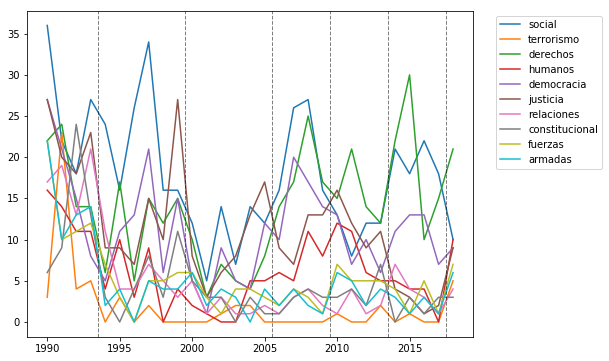

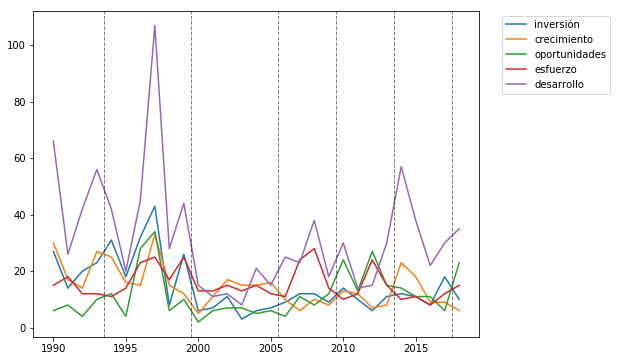

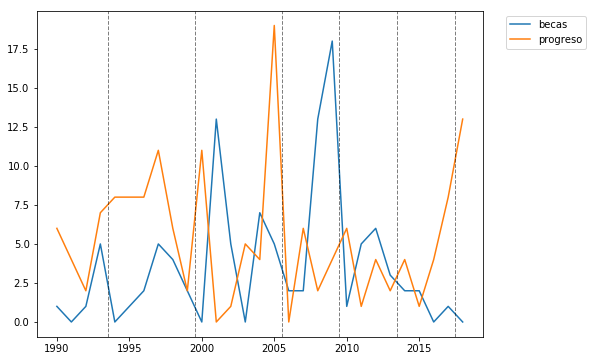

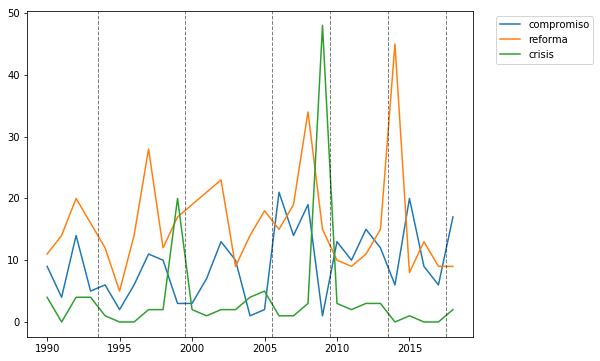

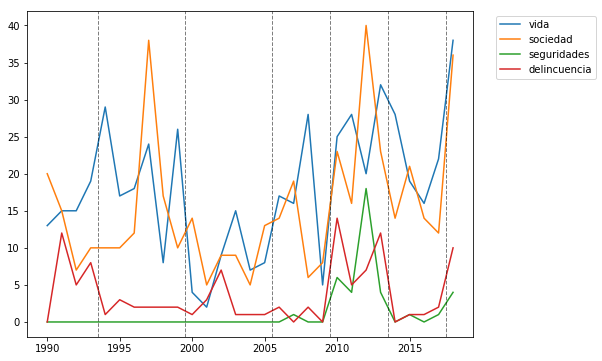

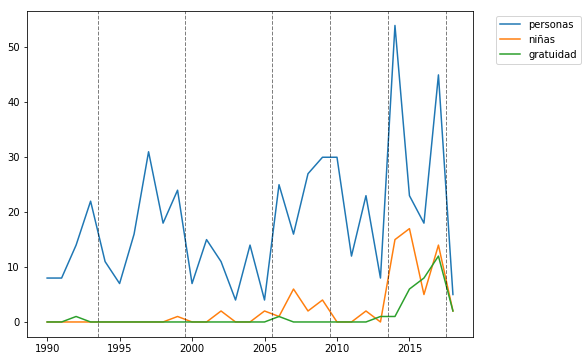

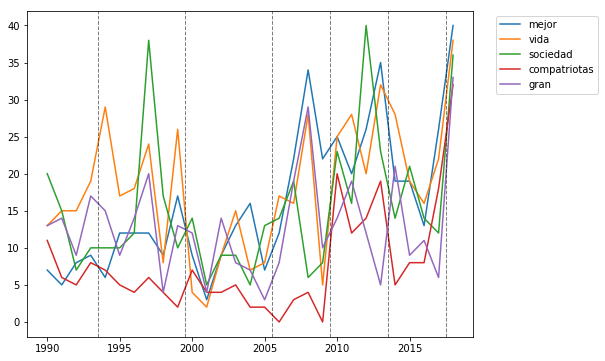

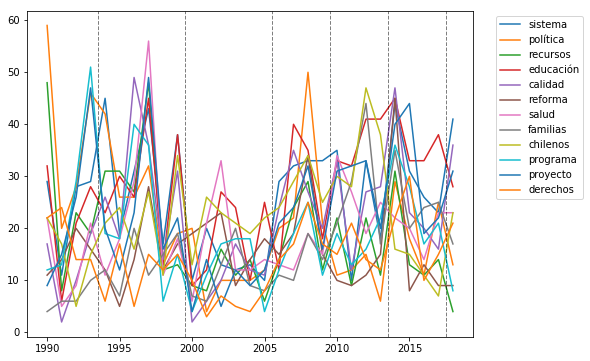

In [315]:
plot_terms(aylwin)
plot_terms(frei)
plot_terms(lagos)
plot_terms(bachelet1)
plot_terms(pinera1)
plot_terms(bachelet2)
plot_terms(pinera2)
plot_terms(todos)

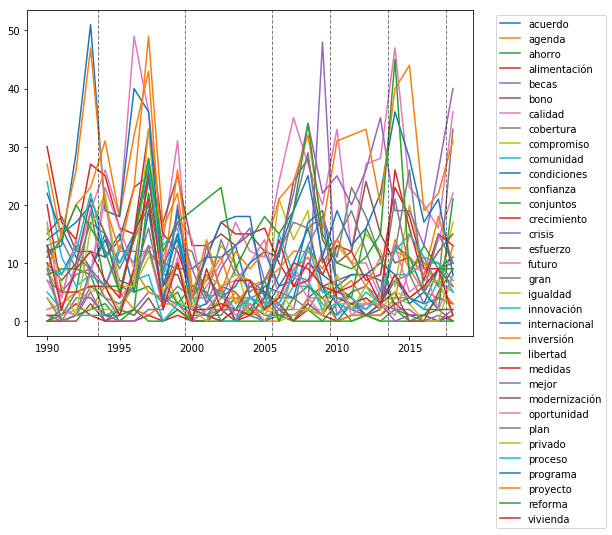

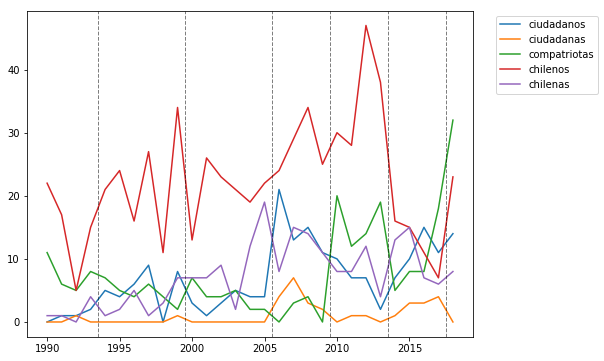

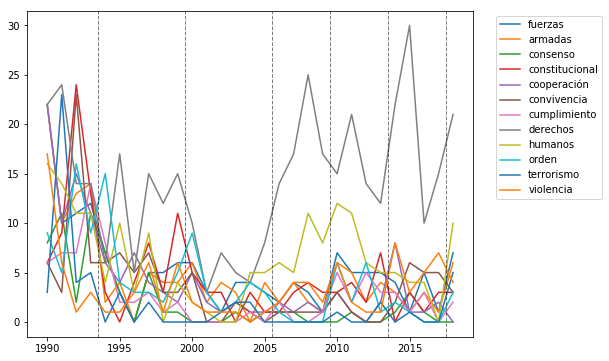

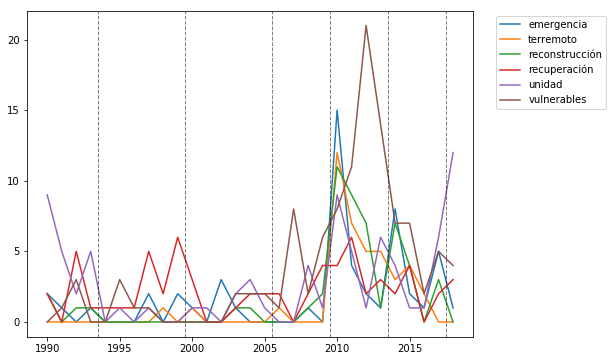

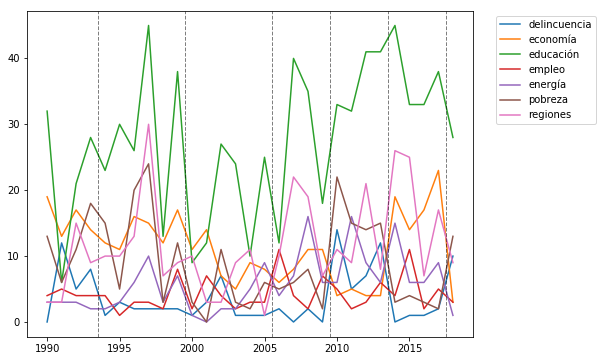

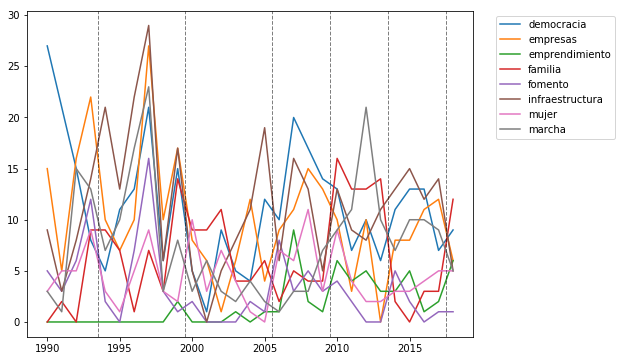

In [310]:
plot_terms(destacados)
plot_terms(apelativos)
plot_terms(palabras_aylwin)
plot_terms(palabras_pinera)
plot_terms(politicas_publicas)
plot_terms(temas_pais)